./segmentation\capture_1756379951.png


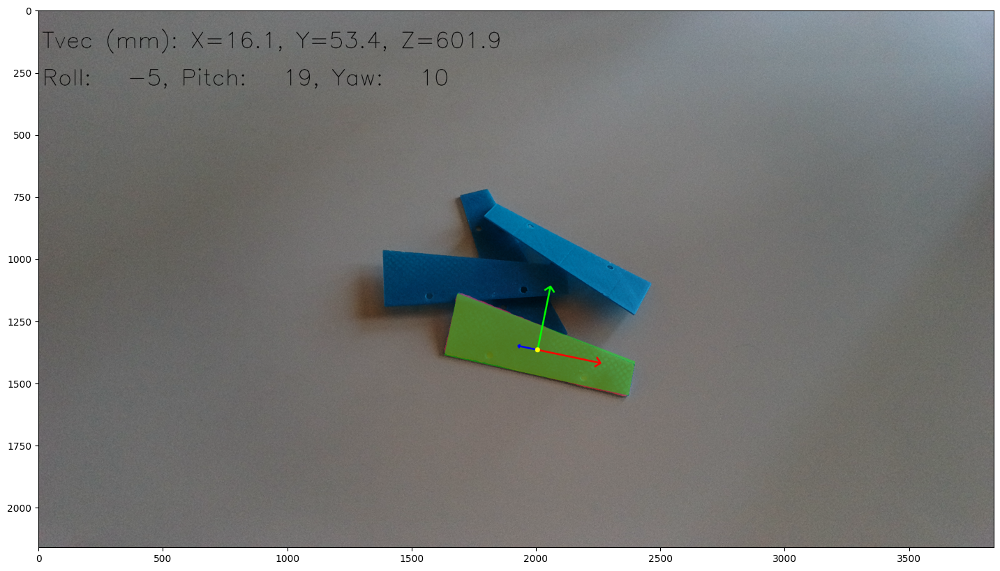

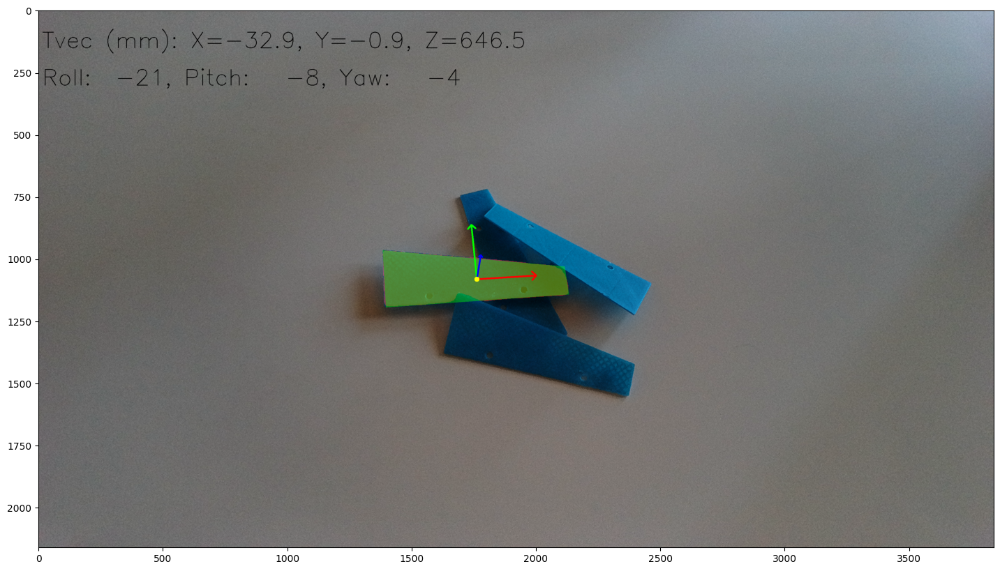

This mask does not match the object! 0.04412066165223838 0.04


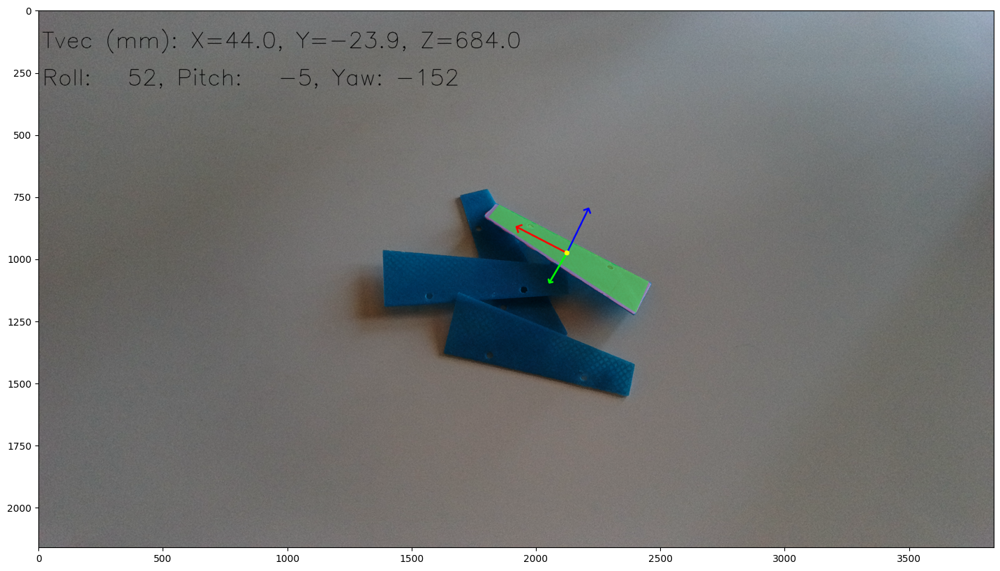

./segmentation\capture_1756379963.png


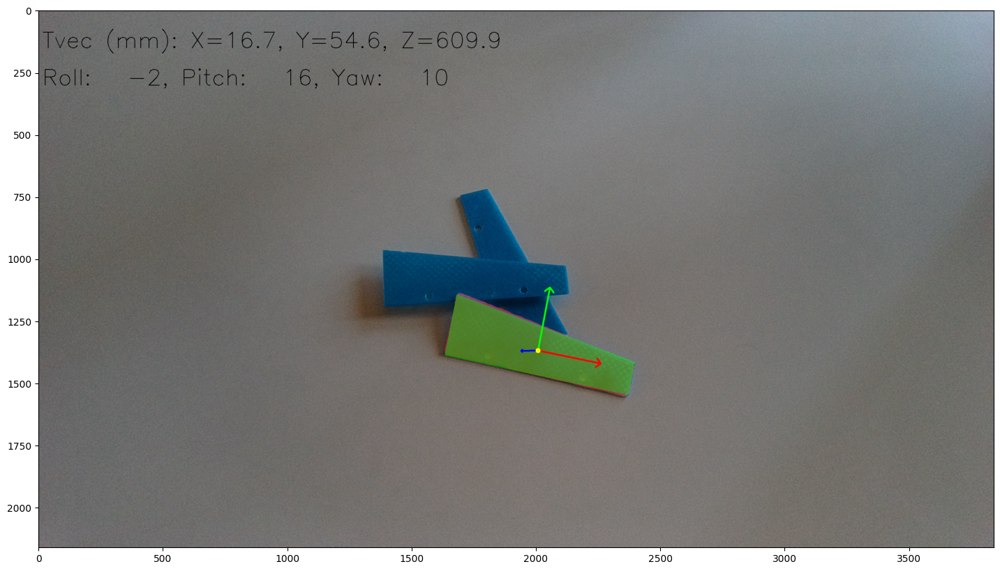

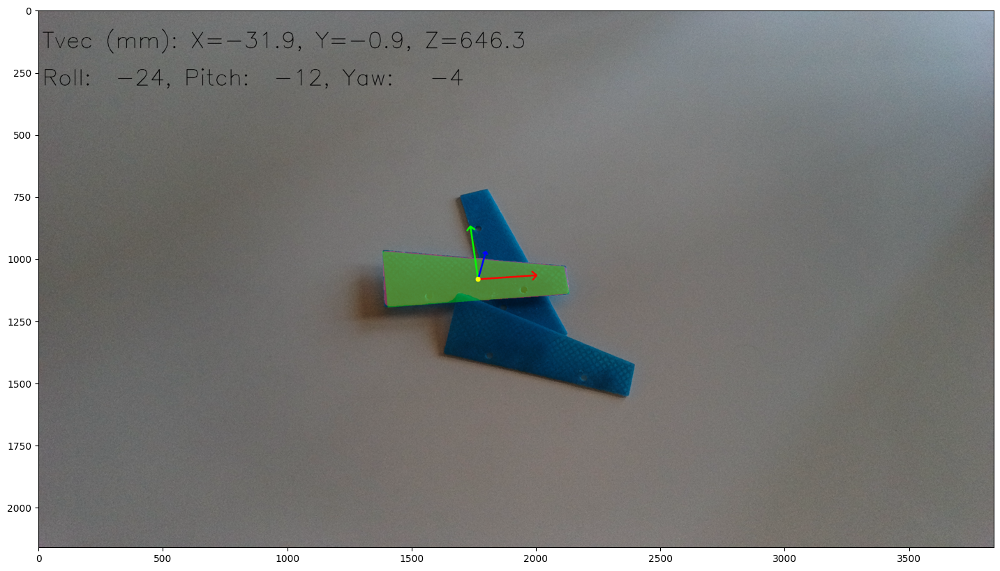

This mask does not match the object! 0.049632635157363714 0.04
./segmentation\capture_1756379970.png


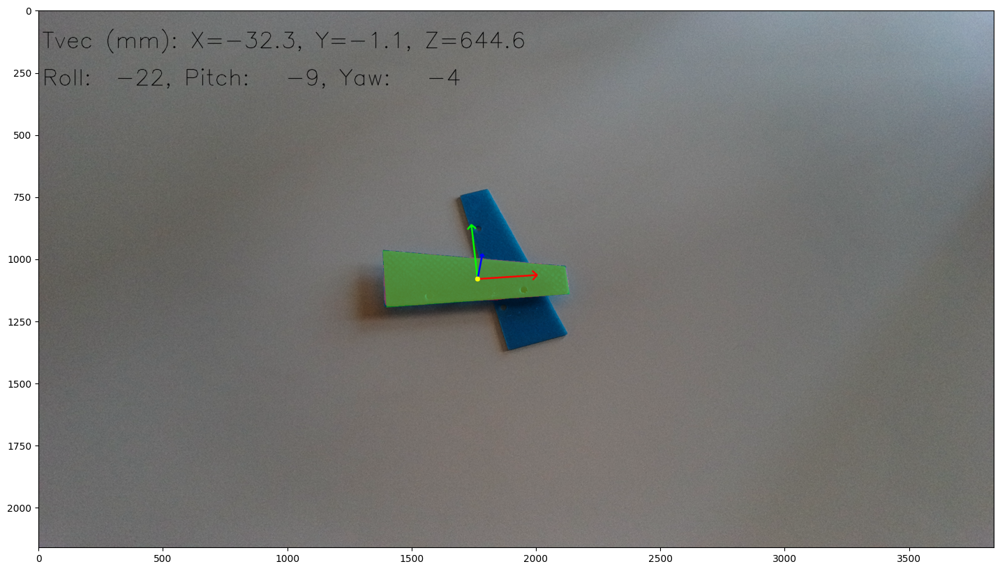

This mask does not match the object! 0.11180856077809675 0.04
This mask does not match the object! 0.049863795011492296 0.04
./segmentation\capture_1756380022.png


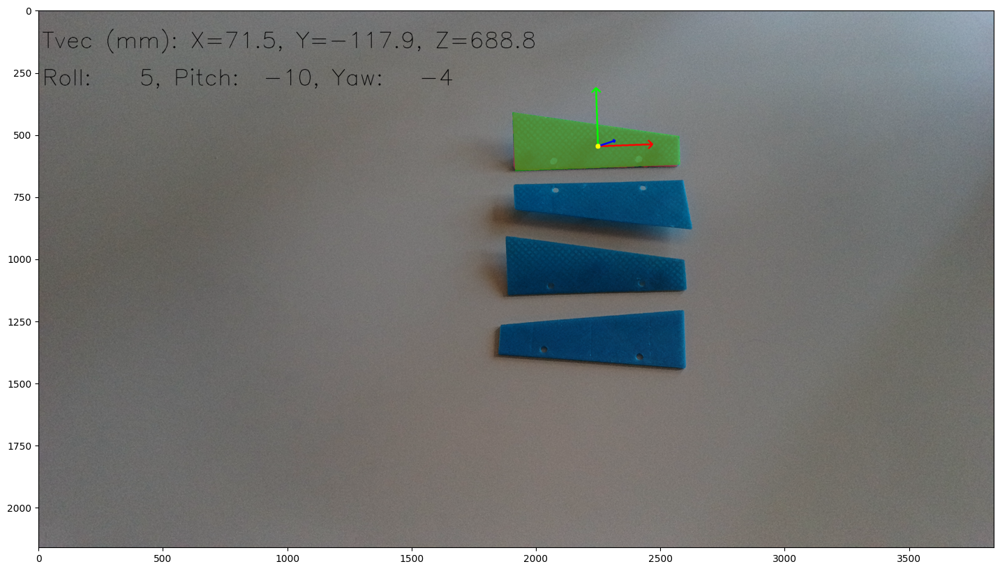

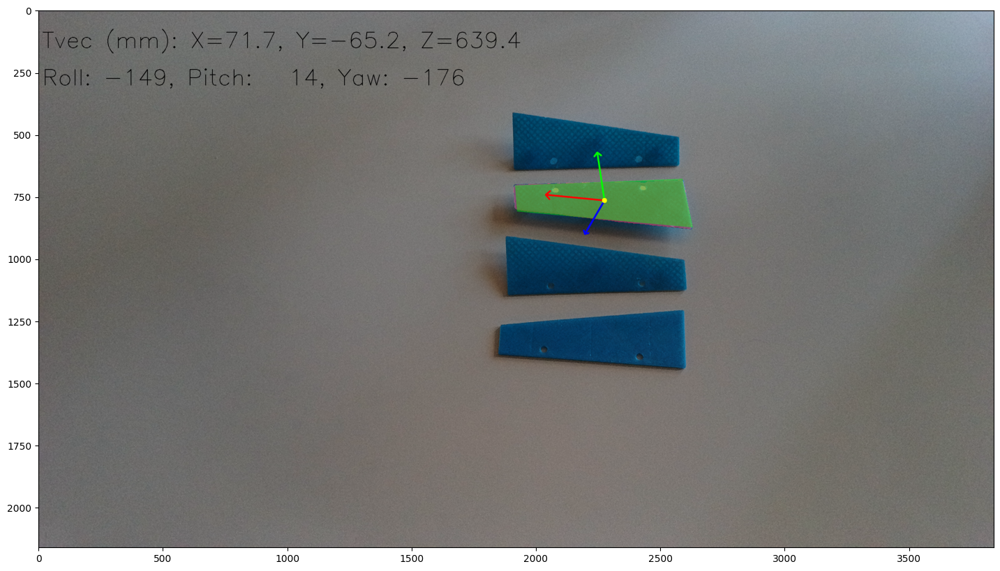

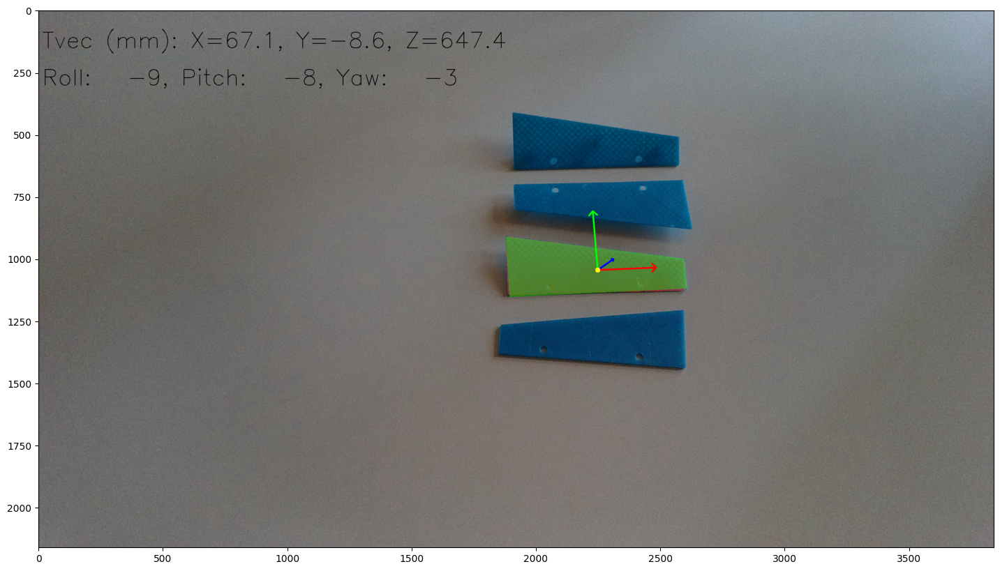

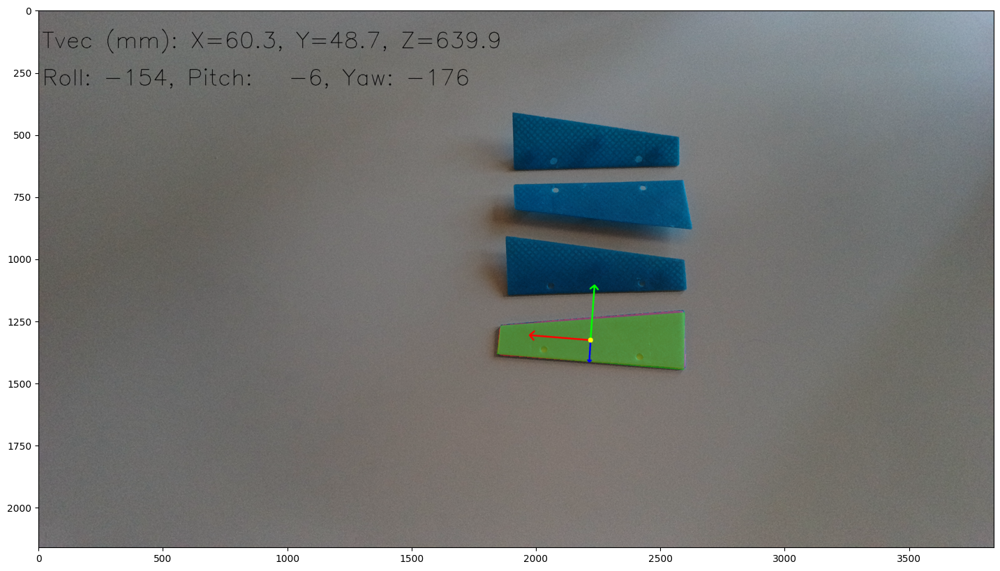

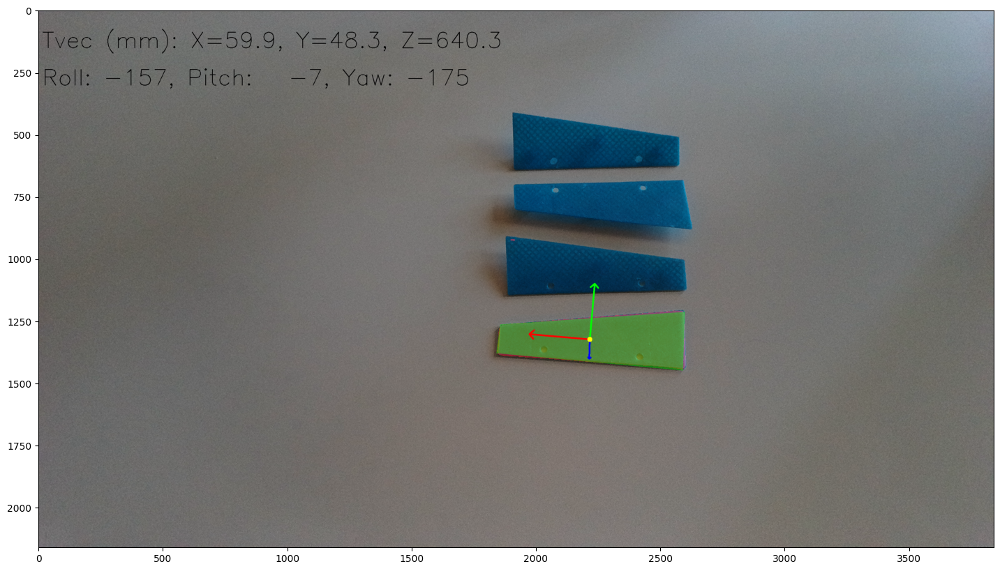

./segmentation\capture_1756382666.png


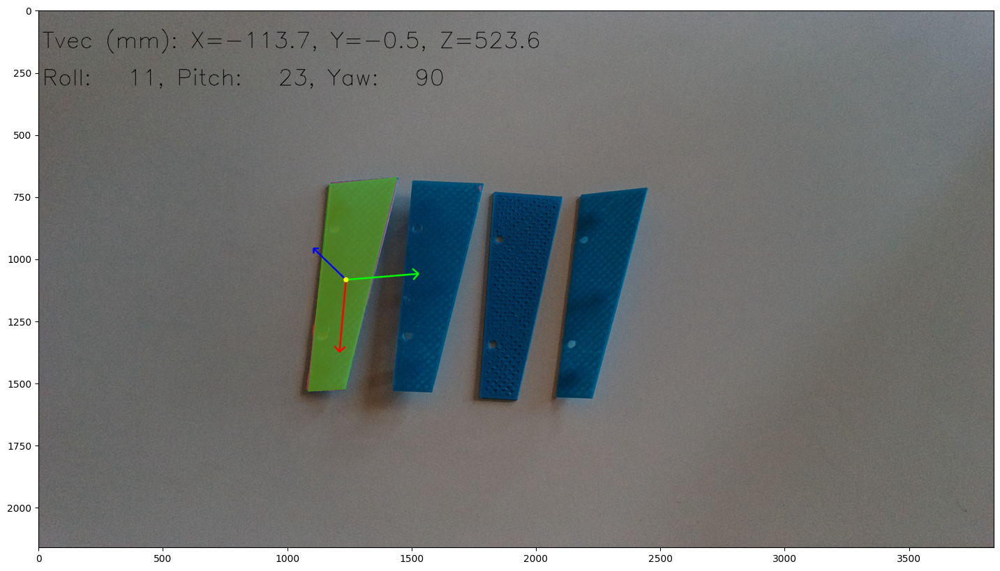

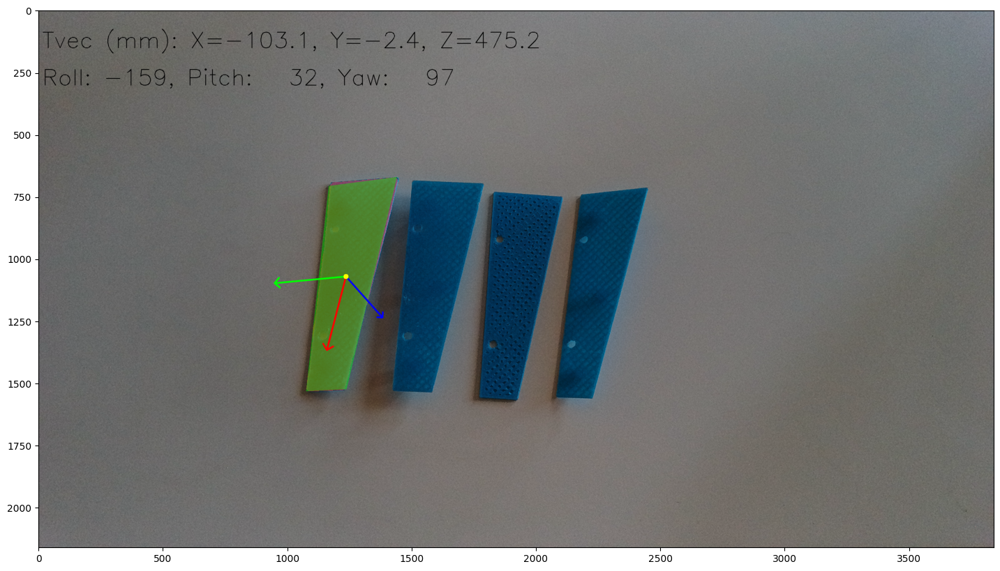

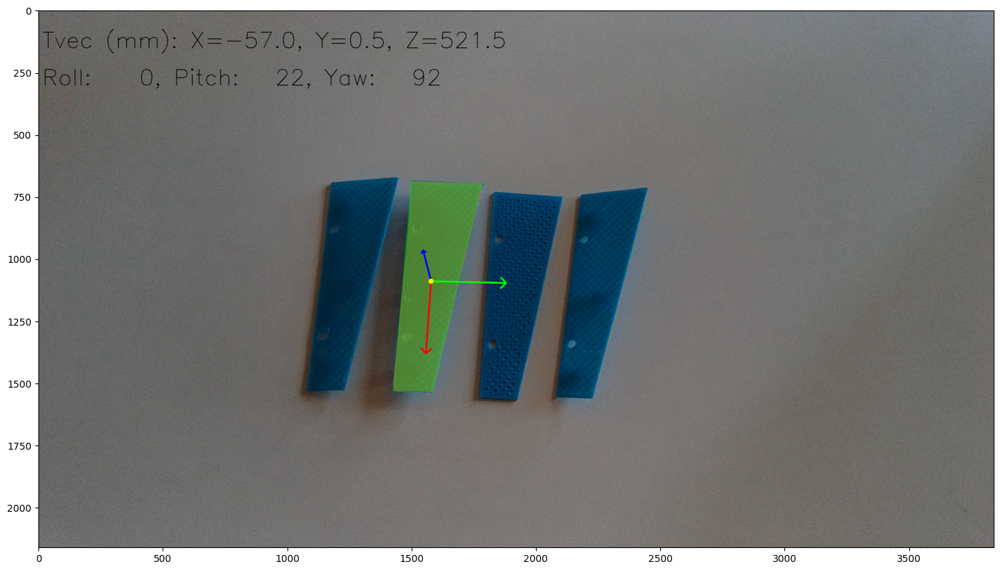

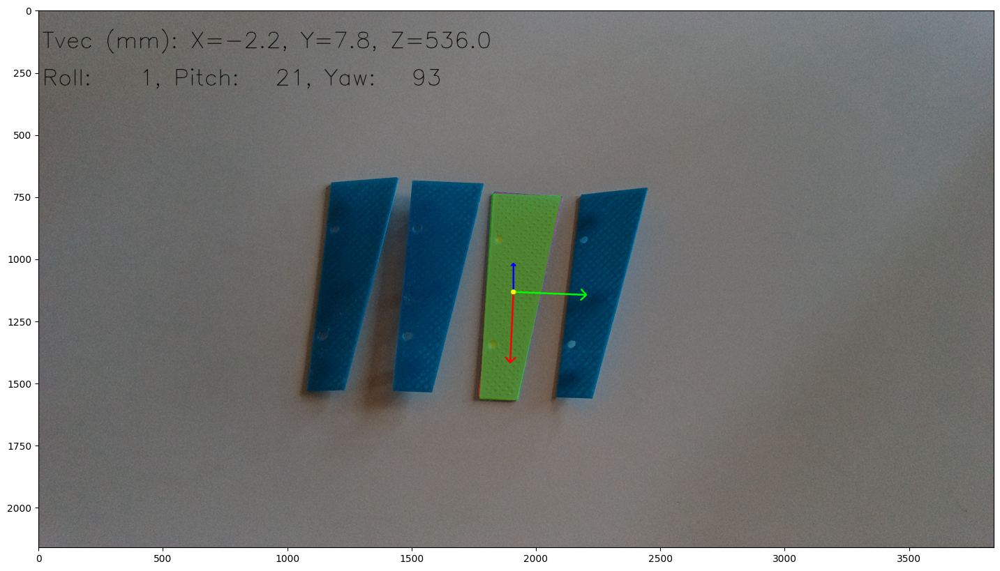

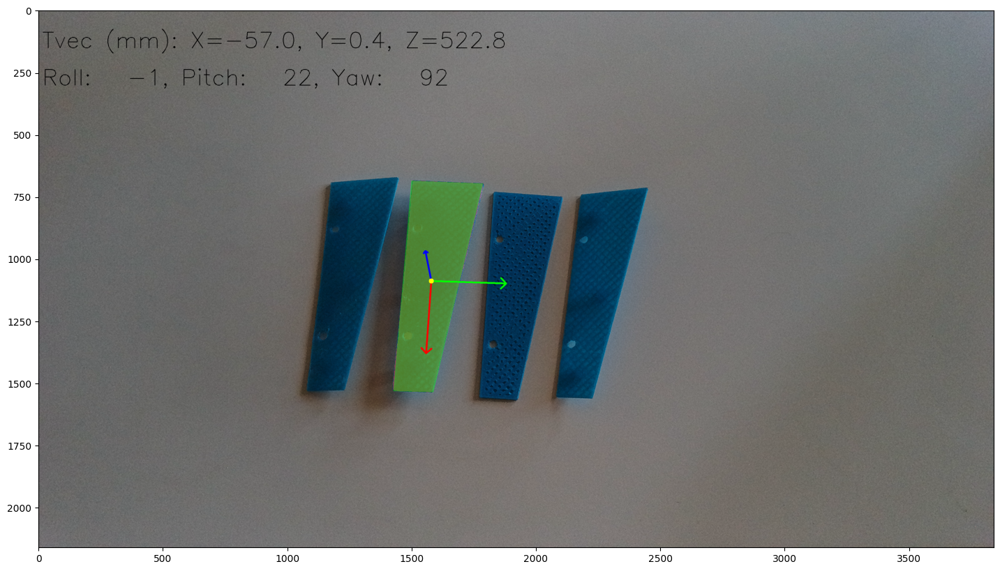

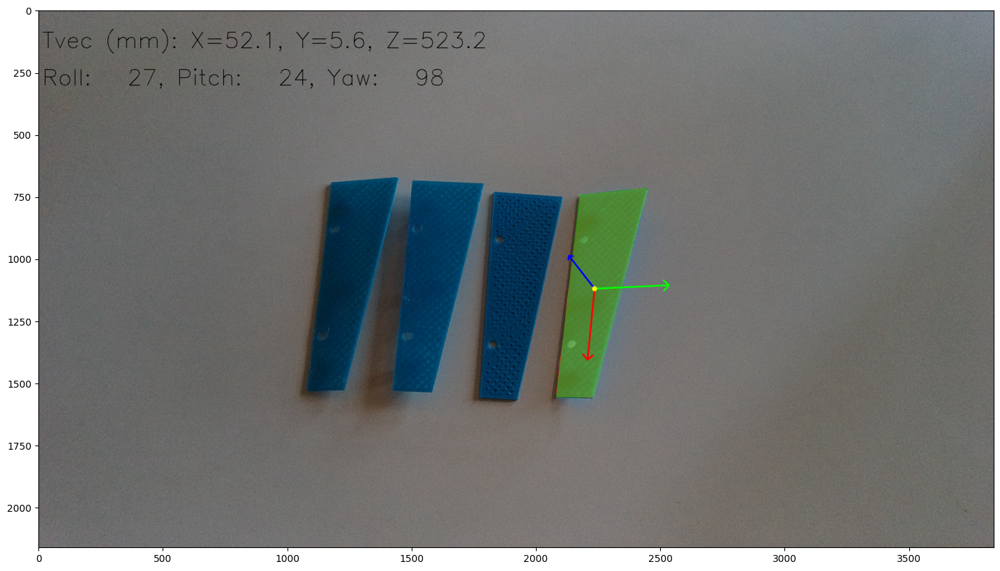

./segmentation\capture_1756383054.png


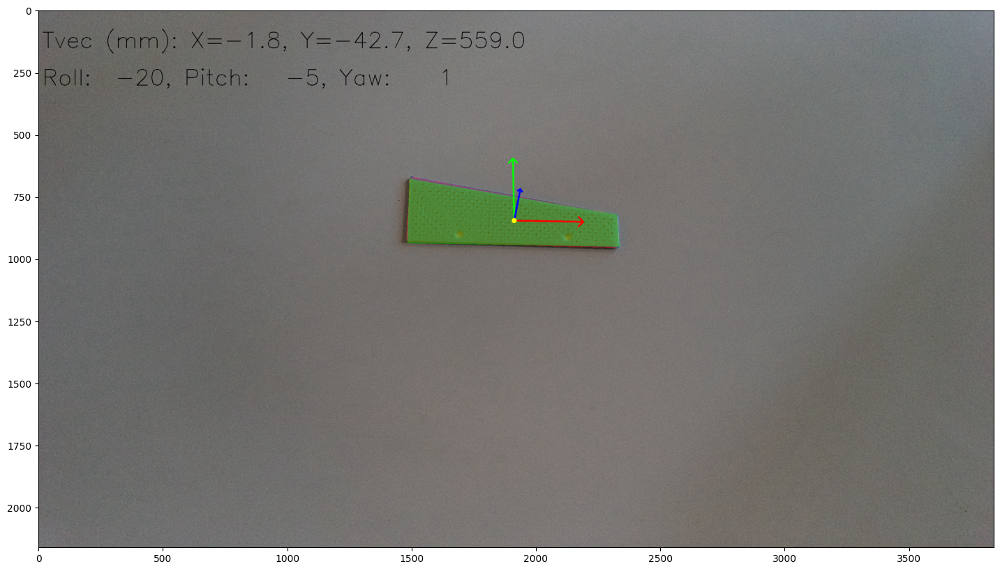

./segmentation\capture_1756383651.png


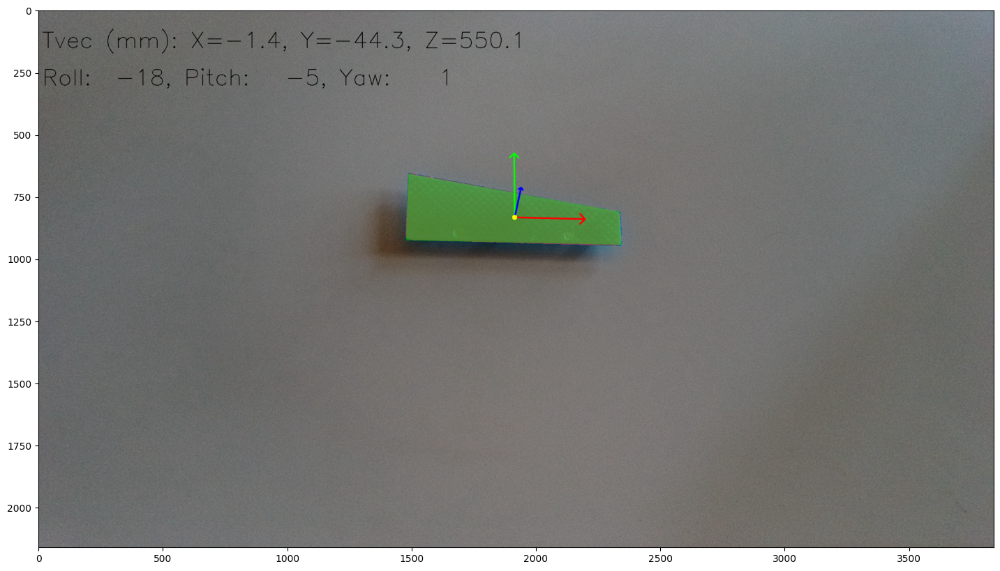

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from math import atan2, asin, degrees
import glob
import traceback


# Params
IMAGE_PATH = './segmentation/*.png'
CAMERA = 'oakd'
CALIBRATION_PATH = './calibration'
PATH = './find_pose'
CAMERA_CALIBRATION = f'{CALIBRATION_PATH}/{CAMERA}/calib_data_oakd.npz'
MAX_IOU_ERROR = 0.04
TEXT_SIZE = 3


# Object points
obj_pts = np.array([ # Plate3 3D printed
    [0, 0, 0],
    [0, 50, 0],
    [150, 50, 0],
    [150, 25, 0],
], dtype=np.float32)

# Image mask processing below
def rotationMatrixToRPY(R):
    sy = np.sqrt(R[0,0]**2 + R[1,0]**2)
    singular = sy < 1e-6
    if not singular:
        x = atan2(R[2,1], R[2,2])
        y = atan2(-R[2,0], sy)
        z = atan2(R[1,0], R[0,0])
    else:
        x = atan2(-R[1,2], R[1,1])
        y = atan2(-R[2,0], sy)
        z = 0
    return degrees(x), degrees(y), degrees(z)

def rotations_and_flips(points):
    n = len(points)
    for shift in range(n):
        yield np.roll(points, shift, axis=0)
        yield np.flip(np.roll(points, shift, axis=0), axis=0)

data = np.load(CAMERA_CALIBRATION)
camera_matrix = data['camera_matrix']
dist_coeffs = data['dist_coeffs']

for image_path in sorted(glob.glob(IMAGE_PATH)):
    # Load image and masks
    try:
        data = np.load(image_path[:image_path.rfind('.')] + '_masks.npz', allow_pickle=True)
        masks = data['masks']
    except:
        continue
        
    print(image_path)
    for mask in masks:
        if mask['area'] < 10000 or mask['area'] > 50000:
            continue

        frame = cv2.imread(image_path)
    
        processed = frame.copy()
        
        binary = mask['segmentation'].astype(np.uint8)
        binary = cv2.resize(binary, (frame.shape[1], frame.shape[0]))
    
        # kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
        # binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel)
        # binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
        # binary = cv2.dilate(binary, kernel, iterations=1)
        
        cnts, _ = cv2.findContours(
            binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if len(cnts) > 0:
            cnt = max(cnts, key=cv2.contourArea)
            
            # cnt = cv2.convexHull(cnt)
            
            # epsilon = 0.02 * cv2.arcLength(cnt, True)
            # approx = cv2.approxPolyDP(cnt, epsilon, True)

            perimeter = cv2.arcLength(cnt, True)
            for factor in np.linspace(0.02, 0.05, 50):
                approx = cv2.approxPolyDP(cnt, factor*perimeter, True)
                if len(approx) == 4:
                    break
        try:
            best = float('inf')
            best_approx = approx.copy()
            changed = True
            threshold = 1.025
            threshold_step = 0.005
            threshold_min = 1.005
            steps = 0
            total_steps = 0
            dirs = [[0,-1],[0,1],[1,-1],[1,1]]
            while threshold > threshold_min and steps < 50 and total_steps < 12:
                # print(total_steps)
                total_steps += 1
                changed = False
                if not changed and total_steps < 10:
                    threshold -= threshold_step
                    total_steps = 0
                    steps = 0
                for k in range(4):
                    for i in range(len(dirs)):
                        approx1 = best_approx.copy()
                        approx1[k,0,dirs[i][0]] = best_approx[k,0,dirs[i][0]] - dirs[i][1]
                        contour_to_draw = approx1  # shape: (N,1,2)
                        contour = np.zeros(binary.shape, dtype=np.uint8)
                        cv2.drawContours(contour, [contour_to_draw], -1, 255, -1)
                        intersection = np.logical_and(contour == 0, binary > 0).sum()
                        # print(steps,total_steps,k,i,best,intersection)
                        if intersection > 0 and intersection < best and best/intersection > threshold:
                            # print(best,intersection,best/intersection)
                            best = intersection
                            best_approx = approx1.copy()
                            changed = True
                            steps += 1
            # print(total_steps, steps)
            approx = best_approx
        except Exception as x:
            traceback.print_exception(x)

        
        img_pts = approx.reshape(-1, 2).astype(np.float32)
        contour_to_draw = approx  # shape: (N,1,2)
        contour = np.zeros(binary.shape, dtype=np.uint8)
        cv2.drawContours(contour, [contour_to_draw], -1, 255, -1)
        
        # plt.figure(figsize=(40,10))
        # plt.subplot(121)
        # plt.imshow(binary, 'gray')
        # plt.subplot(122)
        # plt.imshow(contour, 'gray')
        # plt.show()
    
        best_error = float('inf')
        best_rvec, best_tvec = None, None
    
        for candidate_points in rotations_and_flips(img_pts):
            success = False
            try:
                success, rvec, tvec, inliers = cv2.solvePnPRansac(
                    objectPoints=obj_pts,
                    imagePoints=candidate_points,
                    cameraMatrix=camera_matrix,
                    distCoeffs=dist_coeffs,
                    reprojectionError=0.5,
                    confidence=0.99,
                    flags=cv2.SOLVEPNP_ITERATIVE
                )
            except Exception as x:
                pass
                # traceback.print_exception(x)
            if success:
                proj, _ = cv2.projectPoints(
                    obj_pts, rvec, tvec, camera_matrix, dist_coeffs)
                proj = proj.squeeze().astype(np.int32)
                mask_proj = np.zeros(binary.shape, dtype=np.uint8)
                cv2.fillPoly(mask_proj, [proj], 255)
                intersection = np.logical_and(
                    mask_proj > 0, contour > 0).sum()
                union = np.logical_or(mask_proj > 0, contour > 0).sum()
                iou = intersection / union if union > 0 else 0
                error = 1 - iou
                if error < best_error:
                    best_error = error
                    best_rvec, best_tvec = rvec.copy(), tvec.copy()
    
        rvec = best_rvec
        tvec = best_tvec
        if best_error < MAX_IOU_ERROR:
            # Text info
            R, _ = cv2.Rodrigues(rvec)
            point_in_cam = R @ np.mean(obj_pts,
                                       axis=0).reshape(3, 1) + tvec
            tx, ty, tz = tuple(point_in_cam.flatten())
            text = f'Tvec (mm): X={tx:.1f}, Y={ty:.1f}, Z={tz:.1f}'
            cv2.putText(processed, text, (15,  int(TEXT_SIZE / 0.1 * 5)), cv2.FONT_HERSHEY_SIMPLEX,
                        TEXT_SIZE, (0, 0, 0), 2)
            roll, pitch, yaw = rotationMatrixToRPY(R)
            text = f'Tvec (mm): X={tx:.1f}, Y={ty:.1f}, Z={tz:.1f}'
            cv2.putText(processed, f'Roll: {roll:4.0f}, Pitch: {pitch:4.0f}, Yaw: {yaw:4.0f}',
                        (15,  int(TEXT_SIZE / 0.1 * 10)), cv2.FONT_HERSHEY_SIMPLEX, TEXT_SIZE, (0, 0, 0), 2)
    
            # Object overlay
            img_points_proj, _ = cv2.projectPoints(
                obj_pts, rvec, tvec, camera_matrix, dist_coeffs)
            pts = np.int32(img_points_proj).reshape(-1, 2)

            overlay = np.zeros_like(processed, dtype=np.uint8)
            overlay[binary > 0] = (0, 0, 255)
            alpha = 0.5
            processed = cv2.addWeighted(processed, 1, overlay, alpha, 0)
    
            overlay = processed.copy()
            cv2.fillPoly(overlay, [pts], (0, 255, 0))
            alpha = 0.4
            processed = cv2.addWeighted(
                overlay, alpha, processed, 1 - alpha, 0)

            obj_center = np.mean(obj_pts, axis=0).reshape(1, 1, 3)  # (1,1,3)
            end_point_x_3d = obj_center.copy()
            end_point_x_3d[0,0,0] = end_point_x_3d[0,0,0] + 50
            end_point_y_3d = obj_center.copy()
            end_point_y_3d[0,0,1] = end_point_x_3d[0,0,1] - 50
            end_point_z_3d = obj_center.copy()
            end_point_z_3d[0,0,2] = -50
            center_2d, _ = cv2.projectPoints(obj_center, rvec, tvec, camera_matrix, dist_coeffs)
            end_x_2d, _ = cv2.projectPoints(end_point_x_3d, rvec, tvec, camera_matrix, dist_coeffs)
            end_y_2d, _ = cv2.projectPoints(end_point_y_3d, rvec, tvec, camera_matrix, dist_coeffs)
            end_z_2d, _ = cv2.projectPoints(end_point_z_3d, rvec, tvec, camera_matrix, dist_coeffs)
            
            center_2d = tuple(center_2d.ravel().astype(int))
            end_x_2d = tuple(end_x_2d.ravel().astype(int))
            end_y_2d = tuple(end_y_2d.ravel().astype(int))
            end_z_2d = tuple(end_z_2d.ravel().astype(int))
            
            cv2.arrowedLine(processed, center_2d, end_x_2d, (0,0,255), 5)
            cv2.arrowedLine(processed, center_2d, end_y_2d, (0,255,0), 5)
            cv2.arrowedLine(processed, center_2d, end_z_2d, (255,0,0), 5)
            cv2.circle(processed, center_2d, 10, (0,255,255), -1)
            
            plt.figure(figsize=(40,10))
            plt.imshow(cv2.cvtColor(processed, cv2.COLOR_BGR2RGB))
            plt.show()
        else:
            print('This mask does not match the object!', best_error, MAX_IOU_ERROR)